In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

# Import standard libraries
import os, sys
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.pyplot as plt
import copy
import astropy.units as u
import emcee, corner
import seaborn as sns
import pandas as pd

import chimera

import coronagraph as cg
import smart
import smarter; smarter.utils.plot_setup()

/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/locations.py:345: UserWarning: Extinction files not found in /Users/lustija1/Documents/PandExo_data/pysynphot_data/extinction
  warnings.warn('Extinction files not found in %s' % (extdir, ))
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:117: UserWarning: No graph or component tables found; functionality will be SEVERELY crippled. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmg.fits
  warnings.warn('No graph or component tables found; '
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:124: UserWarning: No thermal tables found, no thermal calculations can be performed. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmt.fits
  warnings.warn('No thermal tables found, '


In [4]:
import run_wasp43_mcmc
import run_wasp43_mcmc_nontrans

In [19]:
#tag = "test7"
tag = "test9"

# Create useful things
emcee_backend = str(tag) + "_emcee.h5"
theta_names = run_wasp43_mcmc.THETA_NAMES
theta0 = run_wasp43_mcmc.THETA0

# Create an HDF5 backend
backend = emcee.backends.HDFBackend(emcee_backend)

iburn = 0#4500#2000#0

Mean acceptance fraction: 22.90%
Mean autocorrelation time: 115.276 steps


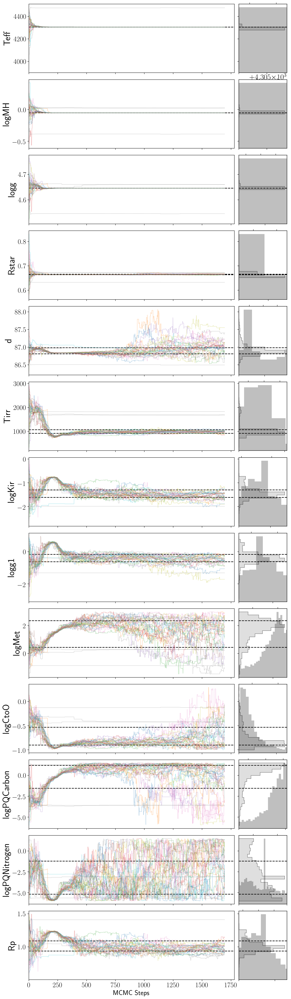

In [20]:
fig, m = run_wasp43_mcmc.plot_mcmc_trace("example", saveplot=False, iburn0=iburn, 
                                          emcee_backend=backend, labels = theta_names, 
                                          accept_quantiles=[0.2, 0.5, 0.8], show_quantiles=True)

In [125]:
chain = backend.get_chain(flat=False, discard = iburn)
flatchain = chain[:,m,:].reshape((-1, len(theta_names)))

In [6]:
chain = backend.get_chain(flat=False, discard = iburn)
m = np.std(chain, axis=0)[:,-1] > np.mean(np.std(chain, axis=0)[:,-1])/10
flatchain = chain[:,m,:].reshape((-1, len(theta_names)))

In [64]:
flatchain = backend.get_chain(flat=True, discard = iburn)
#m = np.sum(np.fabs(flatchain - np.median(flatchain, axis=0)) > 3.0*np.std(flatchain, axis=0), axis =1) == 0

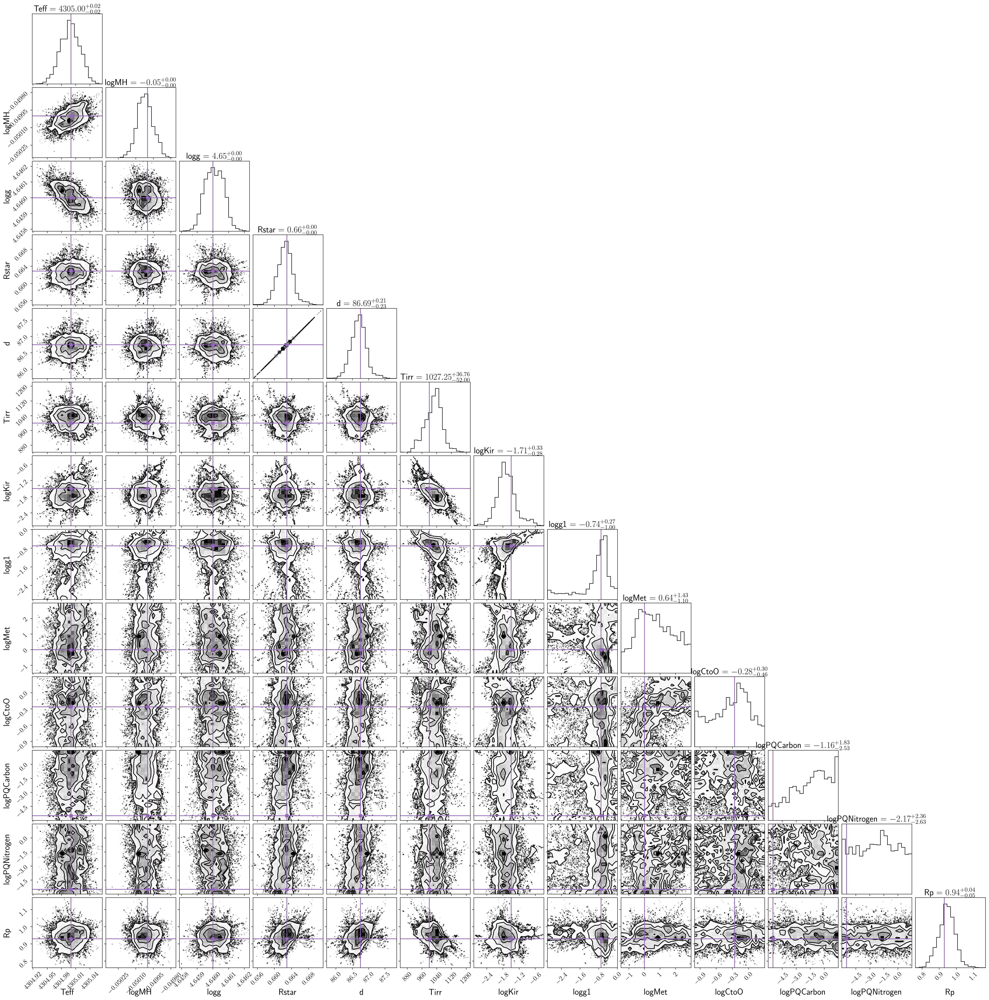

In [7]:
# Make corner plot
fig = corner.corner(flatchain, labels = theta_names, show_titles=True, truths=theta0, truth_color="C4")

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s.png" %tag, bbox_inches = "tight")

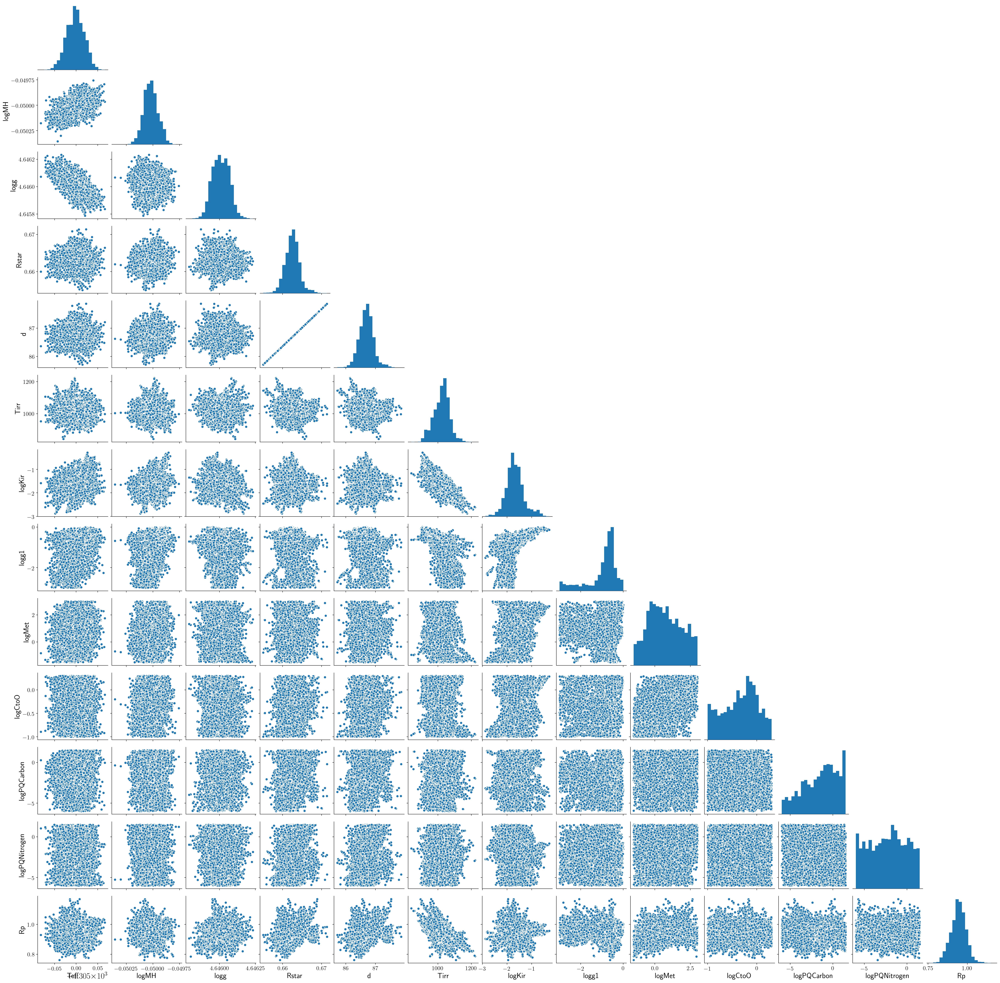

In [8]:
df = pd.DataFrame(flatchain, columns=theta_names)
thing = sns.pairplot(df, corner=True, diag_kws={"bins" : 20, "alpha" : 1.0})


# Adjust axis labels
for ax in thing.fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)

In [58]:
acor = backend.get_autocorr_time(discard=iburn, quiet = True) 

N/50 = 36;
tau: [77.13589136 64.75257967 71.1886178  62.16513959 62.1170117  85.19740366
 82.39516193 85.8418199 ]


In [59]:
print(50 * acor < flatchain.shape[0] / 10)
print((flatchain.shape[0] / 10) / (50 * acor))

[ True  True  True  True  True  True  True  True]
[1.12010114 1.33430977 1.21367717 1.38984647 1.39092332 1.01411541
 1.04860526 1.00650243]


## Plot spectra

In [9]:
wl = run_wasp43_mcmc.wl
y_binned = run_wasp43_mcmc.y_binned
y_meas = run_wasp43_mcmc.y_meas
y_err = run_wasp43_mcmc.y_err

In [10]:
blobs = backend.get_blobs(flat=False, discard = iburn)
Fobs_post, Fstar_post, Fplan_post = blobs[:,m,0,:].reshape((-1, len(wl))), blobs[:,m,1,:].reshape((-1, len(wl))), blobs[:,m,2,:].reshape((-1, len(wl)))

In [48]:
if not backend.has_blobs():

    # Get random samples from posterior
    Nsamples = 1000
    inds = np.random.choice(np.arange(flatchain.shape[0]), size = Nsamples, replace = False)
    theta_samples = flatchain[inds, :]

    # Run model at points
    Fobs_post = np.zeros((Nsamples, len(wl)))
    Fstar_post = np.zeros((Nsamples, len(wl)))
    Fplan_post = np.zeros((Nsamples, len(wl)))
    for i, t in enumerate(theta_samples):
        Fobs_post[i,:], Fstar_post[i,:], Fplan_post[i,:] = run_wasp43_mcmc.run_pie_model_general(t)
        
else:
    
    blobs = backend.get_blobs(flat=True, discard = iburn)
    Fobs_post, Fstar_post, Fplan_post = blobs[:,0,:], blobs[:,1,:], blobs[:,2,:]

In [11]:
# Specify the upper and lower 1- and 3-sigma confidence intervals for the spectra
s1 = 0.6827 # 1-sigma
s2 = 0.9545 # 2-sigma
s3 = 0.9973 # 3-sigma
q1 = [0.5 - 0.5*s1, 0.5, 0.5 + 0.5*s1] # 1-sigma quantiles
q3 = [0.5 - 0.5*s3, 0.5, 0.5 + 0.5*s3] # 3-sigma quantiles

# Calculate percentile spectra (returns: lower bound, median, upper bound)
Fobs_l_1, Fobs_50_1, Fobs_h_1 = np.percentile(Fobs_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fobs_l_3, Fobs_50_3, Fobs_h_3 = np.percentile(Fobs_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

Fstar_l_1, Fstar_50_1, Fstar_h_1 = np.percentile(Fstar_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fstar_l_3, Fstar_50_3, Fstar_h_3 = np.percentile(Fstar_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

Fplan_l_1, Fplan_50_1, Fplan_h_1 = np.percentile(Fplan_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fplan_l_3, Fplan_50_3, Fplan_h_3 = np.percentile(Fplan_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

FpFs_obs_l_1, FpFs_obs_50_1, FpFs_obs_h_1 = np.percentile(y_meas/Fstar_post-1.0, list(100.0 * np.array(q1)), axis=0) # 1-sigma
FpFs_obs_l_3, FpFs_obs_50_3, FpFs_obs_h_3 = np.percentile(y_meas/Fstar_post-1.0, list(100.0 * np.array(q3)), axis=0) # 3-sigma
FpFs_obs_std = 0.5*(FpFs_obs_h_1 - FpFs_obs_l_1)

FpFs_l_1, FpFs_50_1, FpFs_h_1 = np.percentile(Fobs_post/Fstar_post-1.0, list(100.0 * np.array(q1)), axis=0) # 1-sigma
FpFs_l_3, FpFs_50_3, FpFs_h_3 = np.percentile(Fobs_post/Fstar_post-1.0, list(100.0 * np.array(q3)), axis=0) # 3-sigma

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


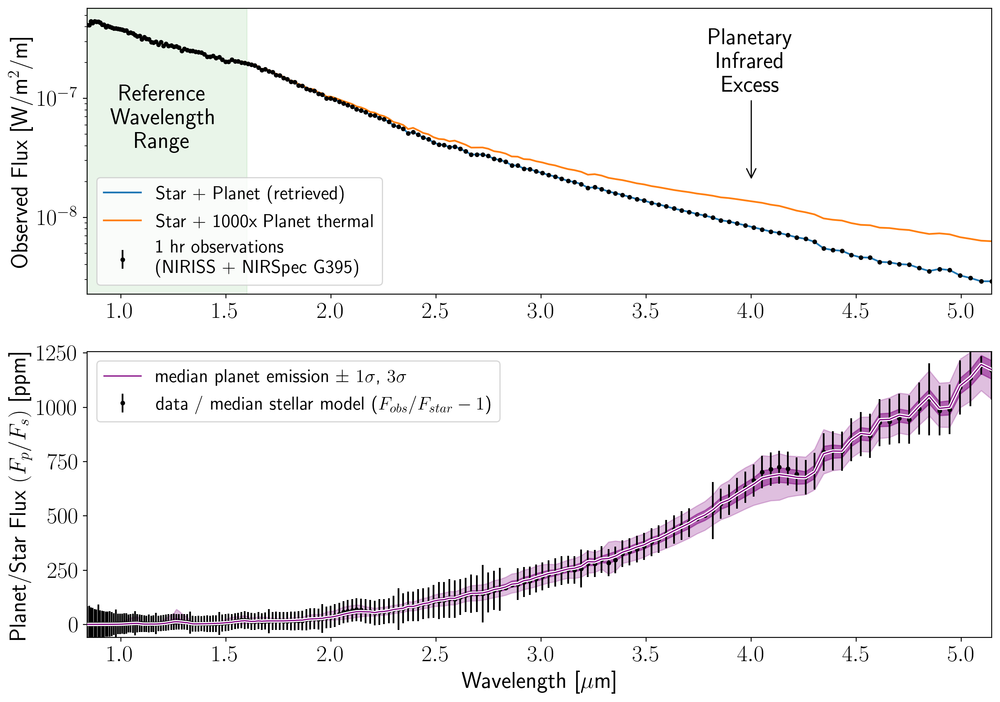

In [12]:
# Plot
fig, axes = plt.subplots(2,1, figsize = (14, 10))
ax= axes[0]
ax2 = axes[1]

ax.set_xlim(wl.min(), wl.max())
ax2.set_xlim(wl.min(), wl.max())
ax2.set_xlabel("Wavelength [$\mu$m]")
ax.set_ylabel("Observed Flux [W/m$^2$/m]")

#ax.plot(wl, y_binned, label = "Star + Planet (truth)", color = "C0")
ax.plot(wl, Fobs_50_1, label = "Star + Planet (retrieved)", color = "C0")
#ax.plot(wl, y_planet, label = "Planet thermal", color = "C3")
ax.errorbar(wl, y_meas, yerr=y_err, fmt = ".k", label = "1 hr observations \n(NIRISS + NIRSpec G395)")
#ax.plot(wl, Fstar_earth + 1000*Fplan_therm_earth, label = "Star + 1000x Planet thermal", color = "C1")
ax.plot(wl, Fstar_50_1 + 1000*Fplan_50_1, label = "Star + 1000x Planet thermal", color = "C1")

ax.set_yscale("log")
ax.legend(fontsize = 16, loc = "lower left")

ax.axvspan(wl.min(), 1.6, color="C2", alpha = 0.1)
ax.text(1.2, 1.3e-7, "Reference\nWavelength\nRange", ha = "center", va = "top")

ax.text(4.0, 2e-7, "Planetary\nInfrared\nExcess", ha = "center", va = "center")
ax.annotate("", xy=(4.0, 2e-8), xytext=(4.0, 1e-7), arrowprops=dict(arrowstyle="->"))

ax2.set_ylabel("Planet/Star Flux $(F_p/F_s)$ [ppm]")
#ax2.plot(wl, 1e6*(y_binned/Fstar_earth-1.0), color = "w", lw = 4.0, zorder = 100)
#ax2.plot(wl, 1e6*(y_binned/Fstar_earth-1.0), color = "C3", label = "Planet-to-Star Flux ($F_{pl}/F_{star}$)", zorder = 100)
#ax2.plot(wl, 1e6*(Fobs/Fstar-1.0), color = "w", lw = 4.0, zorder = 100)

# Plot median spectrum
l1 = ax2.plot(wl, 1e6*FpFs_50_1, lw = 3.0, c="w", zorder = 100, alpha = 1.0)
l2 = ax2.plot(wl, 1e6*FpFs_50_1, lw = 1.0, c="purple", zorder = 100, alpha = 1.0, label = "median planet emission $\pm$ $1 \sigma$, $3 \sigma$")
#ax2.plot(wl, 1e6*(Fobs/Fstar-1.0), color = "C3", label = "Retrieved Planet-to-Star Flux ($F_{pl}/F_{star}$)", zorder = 100)

ylim = ax2.get_ylim()
#ax2.errorbar(wl, 1e6*(FpFs_obs_50_1), yerr = 1e6*np.sqrt((y_err/Fstar_50_1)**2 + (FpFs_obs_std)**2), fmt=".C0")#, label = "propagated error from stellar model")
ax2.errorbar(wl, 1e6*(y_meas/Fstar_50_1-1.0), yerr = 1e6*(y_err/Fstar_50_1), fmt=".k", label = "data / median stellar model ($F_{obs} / F_{star} - 1$)")

# Plot envelopes
ax2.fill_between(wl, 1e6*FpFs_l_1, 1e6*FpFs_h_1, color = "purple", alpha = 0.5)
ax2.fill_between(wl, 1e6*FpFs_l_3, 1e6*FpFs_h_3, color = "purple", alpha = 0.25)

ax2.set_ylim(ylim[0], ylim[1])
ax2.legend(fontsize = 16)
#ax2.set_yscale("log")

fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_spectrum_%s.png" %tag, bbox_inches = "tight")

In [243]:
dict(zip(theta_names, np.mean(flatchain, axis=0)))["Rstar"]

0.6624964834274485

In [242]:
dict(zip(theta_names, np.std(flatchain, axis=0)))["Rstar"]

0.001562109463056263

In [13]:
theta_dict = dict(zip(theta_names, theta0))

df = pd.DataFrame(flatchain, columns=theta_names)

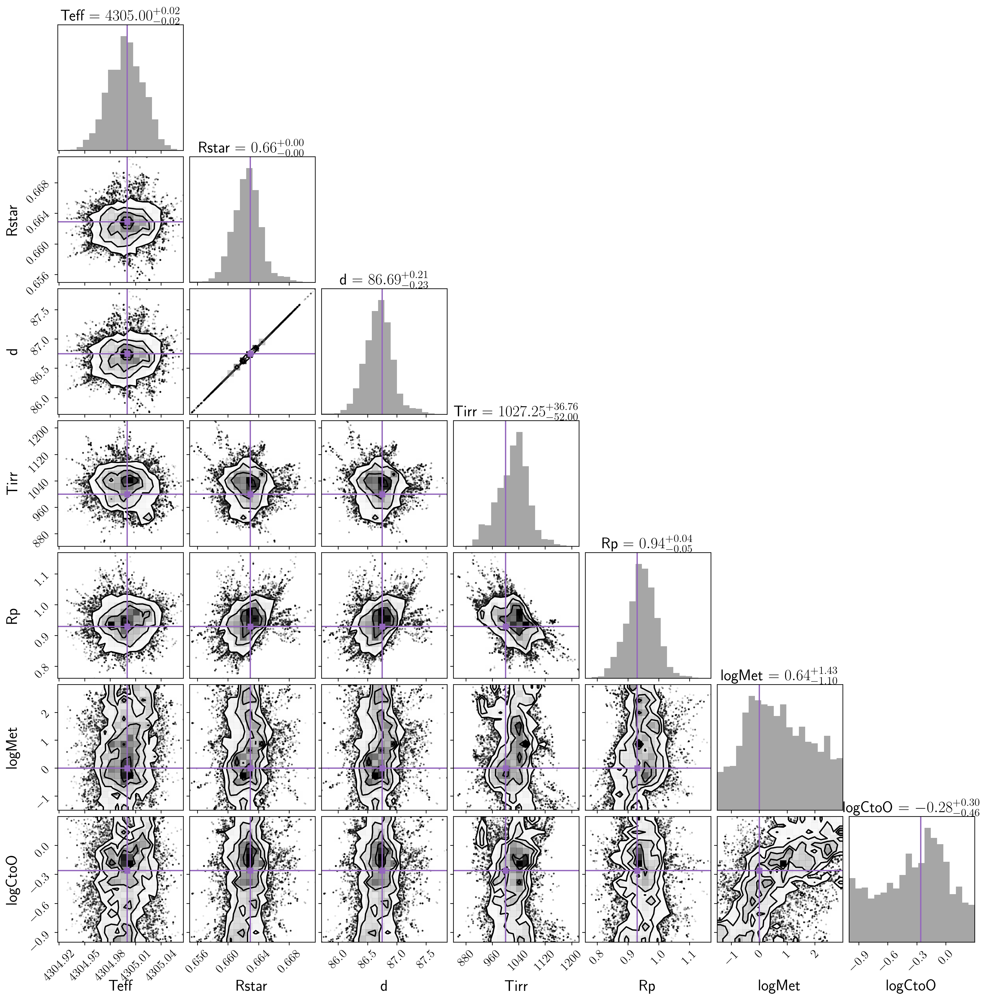

In [14]:
var_names = ["Teff", "Rstar", "d", "Tirr", "Rp", "logMet", "logCtoO"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

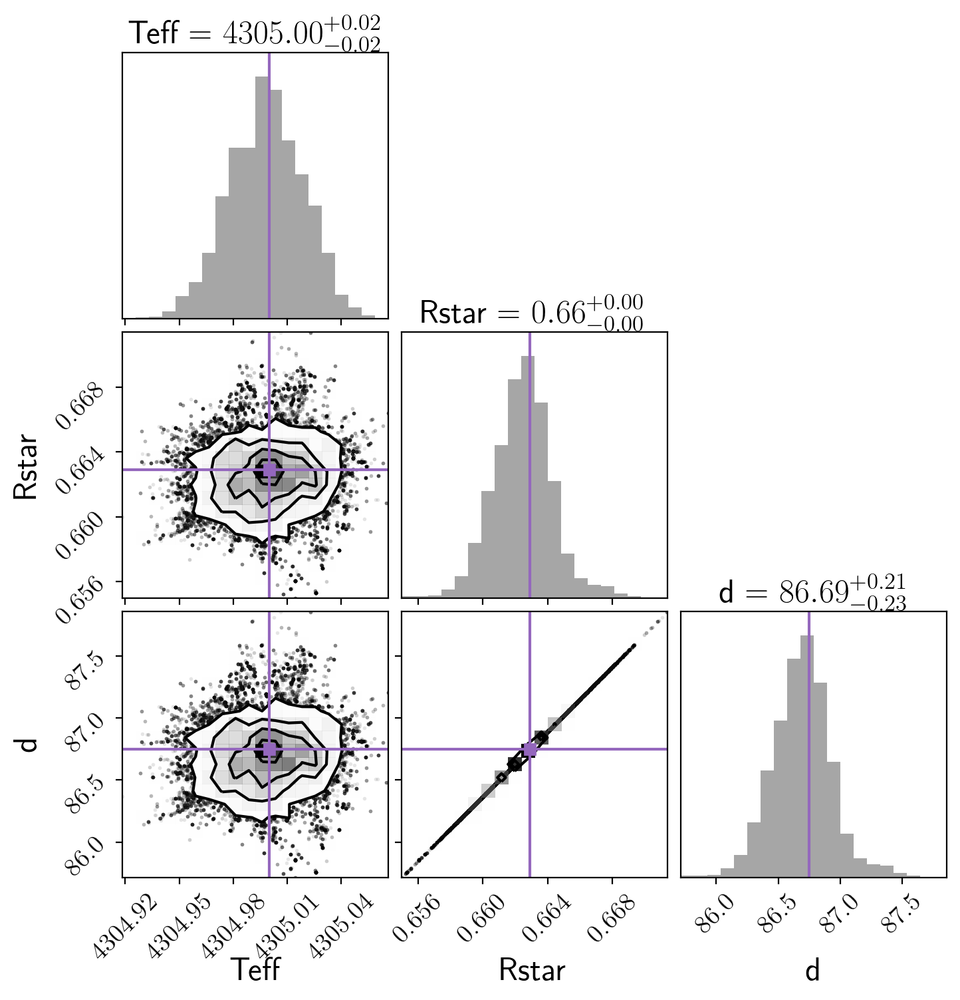

In [15]:
var_names = ["Teff", "Rstar", "d"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

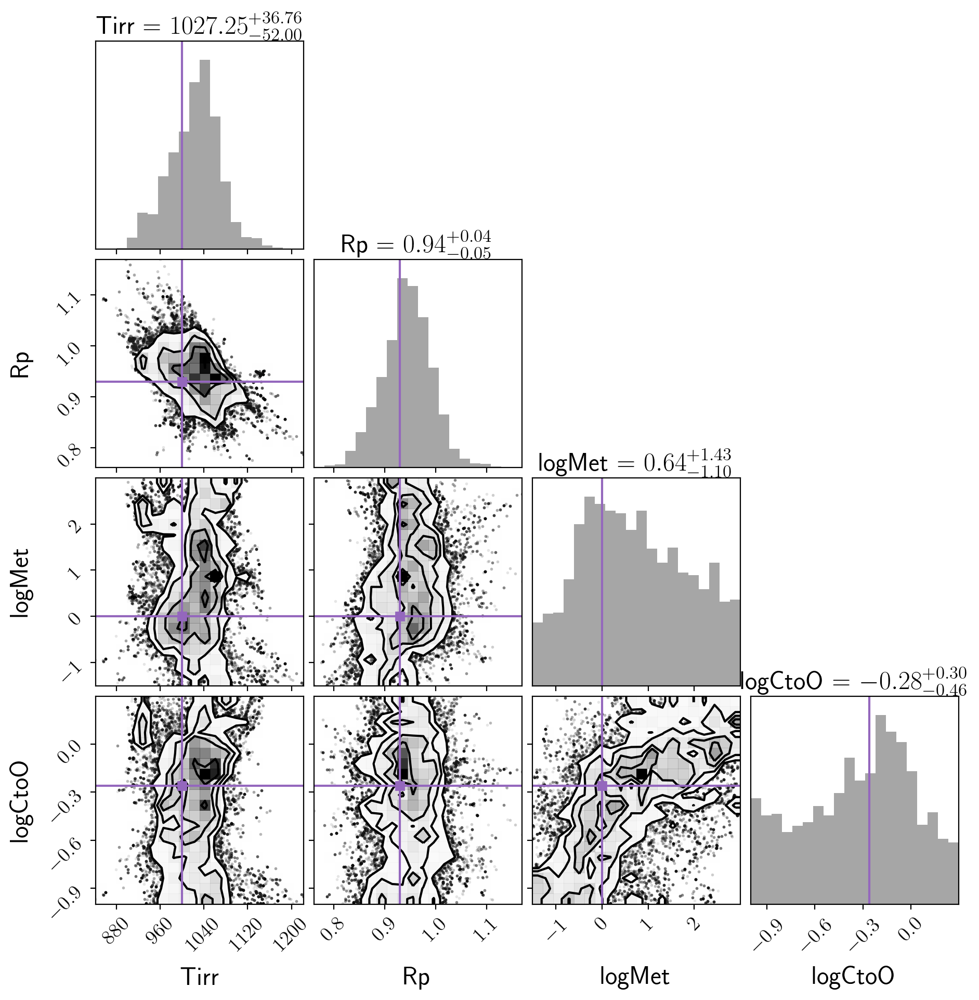

In [16]:
var_names = ["Tirr", "Rp", "logMet", "logCtoO"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

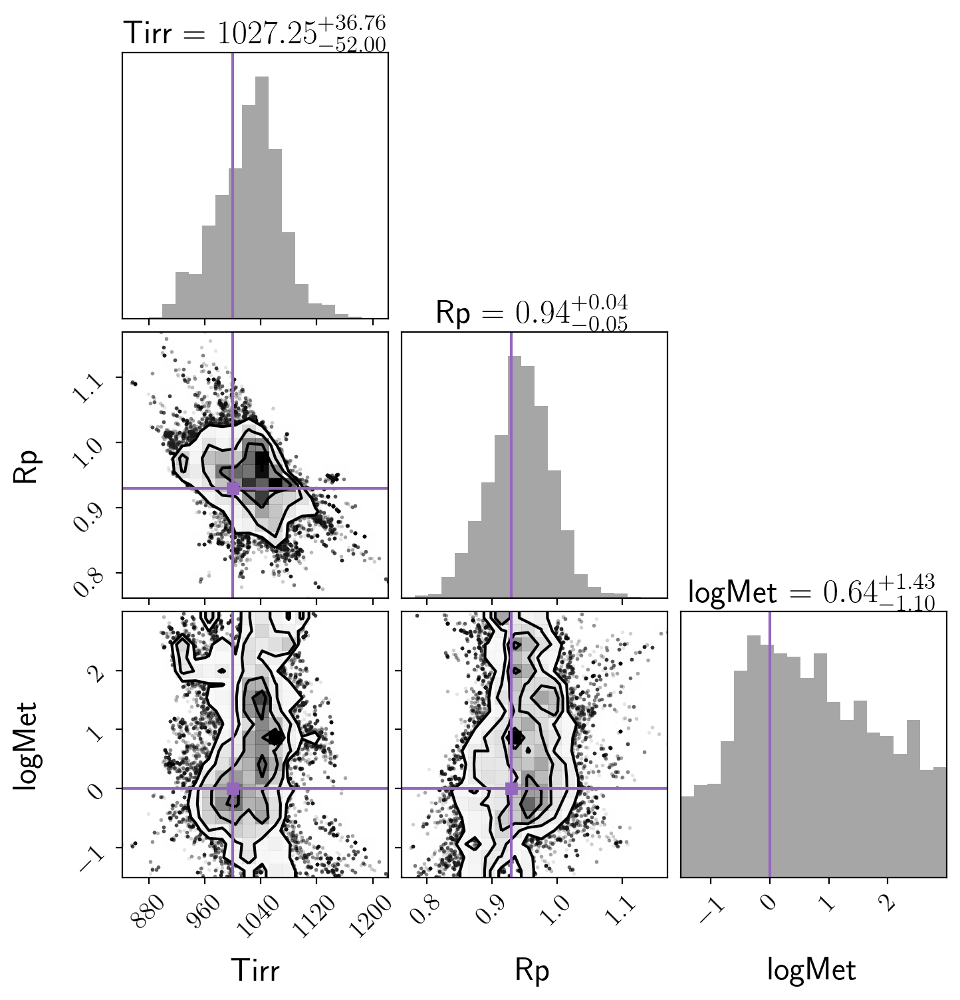

In [17]:
var_names = ["Tirr", "Rp", "logMet"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

## MultiNest Analysis

In [113]:
import pymultinest as pmn
from smarter.processing import multinest_marginals_fancy
import json

n_params = len(run_wasp43_mcmc.PRIORS)

# name of the output files
prefix = os.path.join(tag, "%i-" %n_params)

parameters = theta_names

In [114]:
# Open outputs using Analyzer
a = pmn.Analyzer(n_params = n_params, outputfiles_basename = prefix)

# Get stats from the stats file
s = a.get_stats()

# Extract data
data = a.get_data()
i = data[:,1].argsort()[::-1]
samples = data[i,2:]
weights = data[i,0]
loglike = data[i,1]
Z = s['global evidence']
logvol = np.log(weights) + 0.5 * loglike + Z
logvol = logvol - logvol.max()

# Put crucial data into results dictionary
results = dict(samples=samples, weights=weights, logvol=logvol)

  analysing data from test7/13-.txt


In [116]:
# Make a MultiNest trace plot
fig, axes = multinest_marginals_fancy.traceplot(results,
                                                labels=parameters,
                                                show_titles=False)

# Create color bar on existing figure
rect = [axes[0,0].get_position()._points[0,0],
        axes[0,0].get_position()._points[1,1] + (axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1]),
        axes[0,1].get_position()._points[1,0] - axes[0,0].get_position()._points[0,0],
        0.5*(axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1])]
cax = fig.add_axes(rect)
cbar = fig.colorbar(axes[0,0].collections[0], cax=cax, orientation = "horizontal")
cbar.set_label("Sample Weight ($\mathcal{L}_i w_i / \mathcal{Z}$)",
               labelpad = - 1.5*(axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1]) * fig.dpi * fig.get_size_inches()[1])

# Save plot
fig.savefig(prefix + 'trace.png', bbox_inches='tight')

ValueError: `dataset` input should have multiple elements.